In [2]:
from audio_io import AudioWrapper
import matplotlib.pyplot as plt
import IPython.display as ipd
import librosa as lr
import numpy as np


2025-04-11 20:16:40.031973: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2025-04-11 20:16:40.037610: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-04-11 20:16:40.048344: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-04-11 20:16:40.051651: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-04-11 20:16:40.062616: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instru

In [ ]:
data, sr = lr.load('input/magnolia.mp3', sr=44100)
ipd.Audio(data=data, rate=sr)

In [ ]:
audio = AudioWrapper(path='input/magnolia.mp3', sr=44100)
# audio.cut(3.031984)
audio.split()


start loading


finish loading
started separation


In [5]:
audio.analyze()
# audio.cut(np.float32(-0.5))
# audio.analyze()


model:  90.00476837158203 [  0.67337865   1.3467573    2.008526     2.6819048    3.3436735
   4.017052     4.7020407    5.3754196    6.037188     6.698957
   7.3607254    8.045714     8.707483     9.357641    10.04263
  10.716009    11.377777    12.039546    12.689705    13.363084
  14.013243    14.675011    15.36        16.033379    16.706757
  17.380136    18.041904    18.703672    19.365442    20.02721
  20.70059     21.362358    22.035736    22.697506    23.370884
  24.032652    24.694422    25.3678      26.041178    26.714558
  27.376326    28.038095    28.699863    29.361631    30.035011
  30.69678     31.370157    32.043537    32.705307    33.367073
  34.04045     34.70222     35.36399     36.02576     36.69914
  37.372517    38.034286    38.707664    39.36943     40.0312
  40.70458     41.36635     42.039726    42.701496    43.374874
  44.036644    44.69841     45.36018     46.033558    46.695328
  47.368706    48.042084    48.703854    49.37723     50.039
  50.70077     51.374

[ 0.33668932  0.67337865  1.004263    1.3409524   1.6718367   2.008526
  2.3510203   2.6877098   3.018594    3.3494785   3.6803627   4.022857
  4.3537416   4.6788206   5.021315    5.3580046   5.6888885   6.019773
  6.3448524   6.681542    7.0066214   7.3375053   7.68        8.016689
  8.353378    8.690068    9.020952    9.351836    9.682721   10.013605
 10.350295   10.681179   11.017868   11.348753   11.685442   12.016326
 12.347211   12.6839     13.020589   13.357279   13.688163   14.019048
 14.349932   14.680816   15.017506   15.34839    15.685079   16.021769
 16.352654   16.683537   17.020226   17.35111    17.681995   18.01288
 18.34957    18.686258   19.017143   19.353832   19.684715   20.0156
 20.35229    20.683174   21.019863   21.350748   21.687437   22.018322
 22.349205   22.68009    23.016779   23.347664   23.684353   24.021042
 24.351927   24.688616   25.0195     25.350386   25.687075   26.01796
 26.354649   26.685532   27.022223   27.353106   27.68399    28.014875
 28.351564

(-1.0, 1.0)

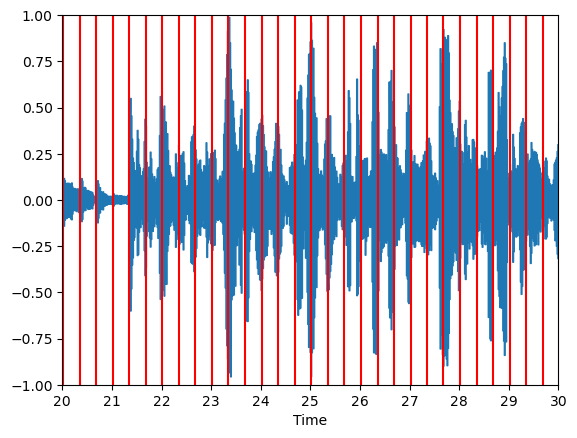

In [6]:
fig = plt.figure()
print(audio.beats)
plt.vlines(x=audio.beats, ymin=-1, ymax=1, colors=['red'])
lr.display.waveshow(audio.data, sr=44100)
plt.xlim((20, 30))
plt.ylim((-1, 1))


In [7]:
import essentia.standard as es
from tempfile import TemporaryDirectory

# Mark beat positions in the audio and write it to a file.
# Use beeps instead of white noise to mark them, as it is more distinctive.
marker = es.AudioOnsetsMarker(onsets=(audio.beats).astype(np.float32), type='beep')
print(audio.beats)
print(type(audio.data), type(data))
marked_audio = marker(np.mean(audio.instrumental, axis=0))

# Write to an audio file in a temporary directory.
temp_dir = TemporaryDirectory()
es.MonoWriter(filename=temp_dir.name + '/dubstep_beats.flac')(marked_audio)
ipd.Audio(temp_dir.name + '/dubstep_beats.flac')

[ 0.33668932  0.67337865  1.004263    1.3409524   1.6718367   2.008526
  2.3510203   2.6877098   3.018594    3.3494785   3.6803627   4.022857
  4.3537416   4.6788206   5.021315    5.3580046   5.6888885   6.019773
  6.3448524   6.681542    7.0066214   7.3375053   7.68        8.016689
  8.353378    8.690068    9.020952    9.351836    9.682721   10.013605
 10.350295   10.681179   11.017868   11.348753   11.685442   12.016326
 12.347211   12.6839     13.020589   13.357279   13.688163   14.019048
 14.349932   14.680816   15.017506   15.34839    15.685079   16.021769
 16.352654   16.683537   17.020226   17.35111    17.681995   18.01288
 18.34957    18.686258   19.017143   19.353832   19.684715   20.0156
 20.35229    20.683174   21.019863   21.350748   21.687437   22.018322
 22.349205   22.68009    23.016779   23.347664   23.684353   24.021042
 24.351927   24.688616   25.0195     25.350386   25.687075   26.01796
 26.354649   26.685532   27.022223   27.353106   27.68399    28.014875
 28.351564

[wav @ 0x5630e99ce620] Using AVStream.codec.time_base as a timebase hint to the muxer is deprecated. Set AVStream.time_base instead.
[wav @ 0x5630e99ce620] Encoder did not produce proper pts, making some up.
